In [4]:
# =============================================================================
# Environment Setup and GPU Configuration
# =============================================================================
import tensorflow as tf
from functions import *
from ppg_functions import *
tf.random.set_seed(42)
np.random.seed(42)

mask_unused_gpus()

import warnings
warnings.filterwarnings("ignore", category=UserWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

Set the following GPU(s) to be visible: 2
Tensorflow session initialized


I0000 00:00:1754648220.125623  360545 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43607 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:c3:00.0, compute capability: 8.6


In [5]:
# --- Load and Inspect BIDMC Dataset ---

import numpy as np
import scipy.io as sio

# Path to the BIDMC .mat file
BIDMC_path = '../Datasets/BIDMC/bidmc_data.mat'
fs = 125  # Sampling frequency (Hz)

X = []
condition = []

# Load the .mat file and extract the 'data' variable
data = sio.loadmat(BIDMC_path)['data']

# Extract signals and assign condition labels
for i in range(data.shape[1]):
    # Extract and flatten the signal for each patient
    signal = data[0][i][1][0][0][0].T.tolist()[0]
    X.append(signal)
    condition.append('UCI')

print('Number of patients:', len(X))
print('Length of signal of first patient (seconds):', len(X[0]) / fs)

# Identify patients with NaN values in their signals
nan_values = [i for i in range(len(X)) if np.isnan(X[i]).any()]
print("Patients with nan values:", nan_values)

# Remove signals with NaN values
X_raw = [X[i] for i in range(len(X)) if i not in nan_values]

# Map each unique condition string to a unique integer
condition_mapping = {label: idx + 1 for idx, label in enumerate(set(condition))}
labels = list(condition_mapping.keys())

# Convert condition labels to integer class labels
y = [condition_mapping[label] for label in condition]

print("Number of classes:", len(set(y)))
print("Class mapping:", condition_mapping)
print("Labels:", labels)

Number of patients: 53
Length of signal of first patient (seconds): 480.008
Patients with nan values: []
Number of classes: 1
Class mapping: {'UCI': 1}
Labels: ['UCI']


In [6]:
# --- Prepare Data: Spectral and Windowed Processing ---

from ppg_functions import *

# Set parameters for data preparation
desired_fs = 100      # Desired sampling frequency (Hz)
nfft = 1024           # Number of FFT points
fs = 125              # Original sampling frequency (Hz)
ff = [0.67, 8]        # Frequency band of interest (Hz)

# Prepare data: compute spectrums and residuals
X, spectrums, residuals = prepare_data(X_raw, y, fs, desired_fs, ff, nfft)

# Set window and overlap for segmentation
w = 85                # Window size
o = 24                # Overlap size

# Set validation and test split proportions
val_p = 0.10
ts_p = 0.20

# Process data into train, validation, and test sets
Xtr, Ytr, Xval, Yval, Xts, Yts, signalsTR, signalsVAL, signalsTS, Itr, Ival, Its = process_data(
    X, y, windows=w, overlap=o, val=val_p, test=ts_p
)

100%|██████████| 53/53 [00:00<00:00, 116.69it/s]

Train labels: (array([1]), array([29008]))
Val labels: (array([1]), array([3920]))
Test labels: (array([1]), array([8624]))


## Compute BIDMC embedding - Autoencoder

In [ ]:
# === Train Autoencoder for BIDMC Embedding ===

folder = 'Output/'
Otr = Xtr
Oval = Xval
Ots = Xts
experiment_name = 'BIDMC_AE'

# Define autoencoder architecture and training options
architecture_options = [
    [[], 3, []],  # Example: single hidden layer with 3 units
]
activation_functions = ['elu']
learning_rates = [0.001]
batch_sizes = [64]
n_splits = 4
epochs = 500

force_train = False

# Train the autoencoder and obtain embeddings
best_autoencoder_model, best_autoencoder_config, errors, Htr_AE, Hval_AE, Hts_AE = train_AE(
    folder,
    0,
    Xtr, Otr, Ytr,
    Xval, Oval, Yval,
    Xts, Ots, Yts,
    labels,
    experiment_name,
    architecture_options,
    activation_functions,
    learning_rates,
    batch_sizes,
    n_splits,
    epochs,
    force_train,
    patience=100
)

I0000 00:00:1754648221.094781  360545 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43607 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:c3:00.0, compute capability: 8.6


BIDMC_AE.pkl file exists
{'architecture': [[], 3, []], 'lr': 0.001, 'batch_size': 64, 'activation': 'elu'}
 87/907 ━━━━━━━━━━━━━━━━━━━━ 0s 582us/step  

I0000 00:00:1754648221.748791  412087 service.cc:148] XLA service 0x7fab140043a0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1754648221.748824  412087 service.cc:156]   StreamExecutor device (0): NVIDIA A40, Compute Capability 8.6
I0000 00:00:1754648221.757409  412087 cuda_dnn.cc:529] Loaded cuDNN version 90300
I0000 00:00:1754648221.830112  412087 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


907/907 ━━━━━━━━━━━━━━━━━━━━ 1s 672us/step
123/123 ━━━━━━━━━━━━━━━━━━━━ 0s 722us/step
270/270 ━━━━━━━━━━━━━━━━━━━━ 0s 646us/step
Best Output: [0.2061212845146656, 0.20601653680205345, [[], 3, []], 0.001, 64, 'elu']


In [8]:
yTS = []
buff_signal_TS = []
labels_TS = []
for i in range(len(signalsTS)):
    buff = buffer_signal(signalsTS[i], w, o)
    buff_signal_TS.extend(buff)
    yTS.extend(i*np.ones(buff.shape[0]))
    labels_TS.append('Patient '+str(i+1))

buff_signal_TS = np.array(buff_signal_TS)

H_AE = best_autoencoder_model.layers[0].predict(buff_signal_TS)
yTS_AE = np.array(yTS)

271/271 ━━━━━━━━━━━━━━━━━━━━ 0s 862us/step


## Compute BIDMC embedding - UMAP Unsupervised

In [9]:
# =============================================================================
# Train UMAP for BIDMC Embedding (Unsupervised)
# =============================================================================

# Prepare integer labels for UMAP training
y = list(range(len(X_raw)))

folder = 'Output/'
experiment_name = 'BIDMC_UMAPU'
n_neighbors = [30]      # Number of neighbors for UMAP
min_dist = [0.3]        # Minimum distance for UMAP
n_components = 3        # Number of embedding dimensions
n_splits = 4            # Number of splits for cross-validation
force_train = False     # Whether to force retraining

# Train UMAP and obtain embeddings for train, validation, and test sets
best_umap_instance, best_UMAP_config, errors, Htr_umap, Hval_umap, Hts_umap = train_umap(
    folder,
    0,
    Xtr, Ytr,
    Xval, Yval,
    Xts, Yts,
    experiment_name,
    labels,
    n_neighbors,
    min_dist,
    n_components,
    n_splits,
    force_train,
    metric='euclidean'
)

BIDMC_UMAPU.pkl file exists
{'n_neighbors': 30, 'n_components': 3, 'min_dist': 0.3}


In [10]:
yTS = []
buff_signal_TS = []
labels_TS = []
for i in range(len(signalsTS)):
    buff = buffer_signal(signalsTS[i], w, o)
    buff_signal_TS.extend(buff)
    yTS.extend(i*np.ones(buff.shape[0]))
    labels_TS.append('Patient '+str(i+1))

buff_signal_TS = np.array(buff_signal_TS)

H_UMAP = best_umap_instance.transform(buff_signal_TS)
yTS_umap = np.array(yTS)


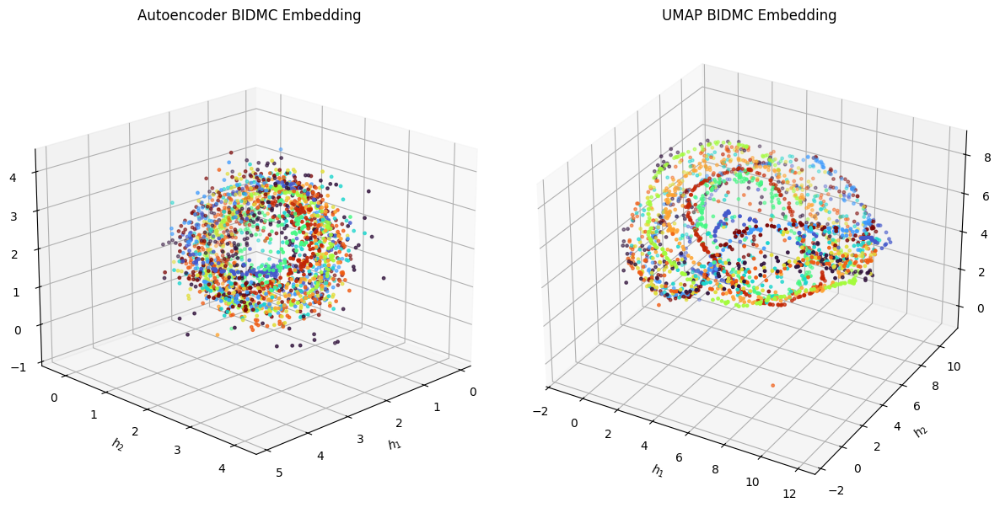

In [11]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Define the sampling function
def sample_array(X, Y, percentage=0.10):
    num_samples = int(X.shape[0] * percentage)  # Calculate the number of samples to keep
    selected_indices = np.random.choice(X.shape[0], num_samples, replace=False)  # Randomly select indices
    return X[selected_indices], Y[selected_indices]

# Sample the data

p=0.25


Hts_AE_sampled, Yts_AE_sampled = sample_array(H_AE, yTS_AE, percentage=p)
Hts_UMAP_sampled, Yts_UMAP_sampled = sample_array(H_UMAP, yTS_umap, percentage=p)

# Create a 1x2 figure layout
fig, ax = plt.subplots(1, 2, figsize=(12, 6), subplot_kw={'projection': '3d'})

# 3D Scatter Plot for Hts_AE
sc1 = ax[0].scatter(Hts_AE_sampled[:, 0], Hts_AE_sampled[:, 1], Hts_AE_sampled[:, 2], 
                     c=Yts_AE_sampled, cmap='turbo', s=6)
ax[0].set_xlabel(r'$h_1$')
ax[0].set_ylabel(r'$h_2$')
ax[0].set_zlabel(r'$h_3$')
ax[0].set_title('Autoencoder BIDMC Embedding')
ax[0].view_init(elev=20,azim=45)

# 3D Scatter Plot for Hts_UMAP
sc2 = ax[1].scatter(Hts_UMAP_sampled[:, 0], Hts_UMAP_sampled[:, 1], Hts_UMAP_sampled[:, 2], 
                     c=Yts_UMAP_sampled, cmap='turbo', s=6)
ax[1].set_xlabel(r'$h_1$')
ax[1].set_ylabel(r'$h_2$')
ax[1].set_zlabel(r'$h_3$')
ax[1].set_title('UMAP BIDMC Embedding')

# Adjust layout
plt.tight_layout()

# Save the figure
plt.savefig("./Figures/BIDMC_AE_UMAP_EMBD_patients.png", dpi=800, bbox_inches='tight')

# Show the plot
plt.show()






## Anomaly Generation and Detection

In [12]:
import numpy as np
from typing import List, Dict, Any, Tuple, Union
import random
from scipy.signal import butter, filtfilt


# Anomaly functions
def reduce_amplitude(signal, start, end, reduction_factor=0.5):
    """
    Reduce the amplitude of a segment of the signal.
    
    Parameters:
    -----------
    signal : np.ndarray
        The input signal.
    start : int
        Start index of the segment to reduce.
    end : int
        End index of the segment to reduce.
    reduction_factor : float, optional
        Factor by which to reduce the amplitude, by default 0.5.
        
    Returns:
    --------
    np.ndarray
        Anomalized signal.
    """
    signal[start:end] *= reduction_factor
    return signal

def increase_amplitude(signal, start, end, increase_factor=2):
    """
    Increase the amplitude of a segment of the signal.
    
    Parameters:
    -----------
    signal : np.ndarray
        The input signal.
    start : int
        Start index of the segment to increase.
    end : int
        End index of the segment to increase.
    increase_factor : float, optional
        Factor by which to increase the amplitude, by default 2.
        
    Returns:
    --------
    np.ndarray
        Anomalized signal.
    """
    signal[start:end] *= increase_factor
    return signal

def add_motion_artifact(signal, start, end, snr, low_freq, high_freq, fs):
    """
    Adds filtered motion artifact noise to a segment of the signal with a defined SNR.

    Parameters:
    - signal (np.ndarray): The original signal to modify.
    - start (int): The starting index for the artifact.
    - end (int): The ending index for the artifact.
    - snr (float): Desired signal-to-noise ratio (linear scale, not dB).
    - low_freq (float): Lower cutoff frequency of the noise (Hz).
    - high_freq (float): Upper cutoff frequency of the noise (Hz).
    - fs (float): Sampling frequency of the signal (Hz).

    Returns:
    - np.ndarray: The signal with the added motion artifact.
    """
    if start < 0 or end > len(signal) or start >= end:
        raise ValueError("Invalid start or end indices.")

    # Generate white noise
    noise = np.random.normal(size=end - start)

    # Design a bandpass filter
    nyquist = 0.5 * fs
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = butter(4, [low, high], btype='band')

    # Filter the white noise
    filtered_noise = filtfilt(b, a, noise)

    # Scale the noise to achieve the desired SNR
    signal_segment = signal[start:end]
    signal_power = np.mean(signal_segment**2)
    noise_power = np.mean(filtered_noise**2)
    scaling_factor = np.sqrt(signal_power / (noise_power * snr))
    scaled_noise = scaling_factor * filtered_noise

    # Add the noise to the specified signal segment
    signal[start:end] += scaled_noise
    return signal

def add_respiratory_modulation(signal, start, end, freq=0.5, amplitude=0.2):
    t = np.linspace(0, (end-start)/len(signal), end-start)
    modulation = np.max(signal)*amplitude * np.sin(2 * np.pi * freq * t)
    signal[start:end] += modulation
    return signal

def add_high_frequency_noise(signal, start, end, snr, low_freq, high_freq, fs):
    """
    Adds high-frequency noise to a segment of the signal.

    Parameters:
    - signal (np.ndarray): The original signal to modify.
    - start (int): Starting index for adding noise.
    - end (int): Ending index for adding noise.
    - snr (float): Desired signal-to-noise ratio (linear scale, not dB).
    - low_freq (float): Lower cutoff frequency of the noise (Hz).
    - high_freq (float): Upper cutoff frequency of the noise (Hz).
    - fs (float): Sampling frequency of the signal (Hz).

    Returns:
    - np.ndarray: Signal with added high-frequency noise.
    """
    if start < 0 or end > len(signal) or start >= end:
        raise ValueError("Invalid start or end indices.")

    # Generate white noise
    noise = np.random.normal(size=end - start)

    # Design a bandpass filter for high frequencies
    nyquist = 0.5 * fs
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = butter(4, [low, high], btype='band')

    # Filter the white noise
    high_freq_noise = filtfilt(b, a, noise)

    # Scale noise to match the desired SNR
    signal_segment = signal[start:end]
    signal_power = np.mean(signal_segment**2)
    noise_power = np.mean(high_freq_noise**2)
    scaling_factor = np.sqrt(signal_power / (noise_power * snr))
    scaled_noise = scaling_factor * high_freq_noise

    # Add noise to the signal segment
    signal[start:end] += scaled_noise
    return signal

def add_low_frequency_noise(signal, start, end, snr, low_freq, high_freq, fs):
    """
    Adds low-frequency noise to a segment of the signal.

    Parameters:
    - signal (np.ndarray): The original signal to modify.
    - start (int): Starting index for adding noise.
    - end (int): Ending index for adding noise.
    - snr (float): Desired signal-to-noise ratio (linear scale, not dB).
    - low_freq (float): Lower cutoff frequency of the noise (Hz).
    - high_freq (float): Upper cutoff frequency of the noise (Hz).
    - fs (float): Sampling frequency of the signal (Hz).

    Returns:
    - np.ndarray: Signal with added low-frequency noise.
    """
    if start < 0 or end > len(signal) or start >= end:
        raise ValueError("Invalid start or end indices.")

    # Generate white noise
    noise = np.random.normal(size=end - start)

    # Design a bandpass filter for low frequencies
    nyquist = 0.5 * fs
    low = low_freq / nyquist
    high = high_freq / nyquist
    b, a = butter(4, [low, high], btype='band')

    # Filter the white noise
    low_freq_noise = filtfilt(b, a, noise)

    # Scale noise to match the desired SNR
    signal_segment = signal[start:end]
    signal_power = np.mean(signal_segment**2)
    noise_power = np.mean(low_freq_noise**2)
    scaling_factor = np.sqrt(signal_power / (noise_power * snr))
    scaled_noise = scaling_factor * low_freq_noise

    # Add noise to the signal segment
    signal[start:end] += scaled_noise
    return signal

def apply_anomalies(signal, control_params):
    total_samples = len(signal)
    anomalized_signal = signal.copy()

    # Initialize the anomaly position vector with 0s
    anomaly_positions = np.zeros(total_samples, dtype=int)

    # Total samples to be anomalized
    target_anomalized_samples = int(total_samples * control_params['anomaly_percentage'])

    # List of anomalies and their corresponding parameter ranges
    anomalies = control_params['anomalies']

    anomalized_samples = 0

    while anomalized_samples < target_anomalized_samples:
        # Randomly choose an anomaly and its parameter range
        anomaly = random.choice(anomalies)
        start = random.randint(0, total_samples - 1)
        segment_length = random.randint(*control_params['segment_length_range'])

        # Ensure that the end doesn't go beyond the signal length
        end = min(start + segment_length, total_samples)

        if (end - start > control_params['segment_length_range'][0]):
            # Apply the selected anomaly
            if anomaly['type'] == 'reduce_amplitude':
                reduction_factor = random.uniform(*anomaly['params']['reduction_factor_range'])
                anomalized_signal = reduce_amplitude(anomalized_signal, start, end, reduction_factor)
            
            elif anomaly['type'] == 'increase_amplitude':
                increase_factor = random.uniform(*anomaly['params']['increase_factor_range'])
                anomalized_signal = increase_amplitude(anomalized_signal, start, end, increase_factor)
            
            elif anomaly['type'] == 'motion_artifact':
                snr = random.uniform(*anomaly['params']['snr_range'])
                low_freq = anomaly['params']['low_freq_cutoff']
                high_freq = anomaly['params']['high_freq_cutoff']
                fs =  control_params['fs']
                anomalized_signal = add_motion_artifact(anomalized_signal, start, end, snr, low_freq, high_freq, fs)
            
            elif anomaly['type'] == 'high_frequency_noise':
                snr = anomaly['params']['snr']
                low_freq = anomaly['params']['low_freq_cutoff']
                high_freq = anomaly['params']['high_freq_cutoff']
                fs =  control_params['fs']
                anomalized_signal = add_high_frequency_noise(anomalized_signal, start, end, snr, low_freq, high_freq,fs)
            
            elif anomaly['type'] == 'low_frequency_noise':
                snr = anomaly['params']['snr']
                low_freq = anomaly['params']['low_freq_cutoff']
                high_freq = anomaly['params']['high_freq_cutoff']
                fs =  control_params['fs']
                anomalized_signal = add_low_frequency_noise(anomalized_signal, start, end, snr, low_freq, high_freq,fs)

            elif anomaly['type'] == 'respiratory_modulation':
                freq = random.uniform(*anomaly['params']['freq_range'])
                amplitude = random.uniform(*anomaly['params']['amplitude_range'])
                anomalized_signal = add_respiratory_modulation(anomalized_signal, start, end, freq, amplitude)

            # Mark the anomaly in the anomaly_positions vector
            anomaly_positions[start:end] = 1

            # Update the count of anomalized samples
            anomalized_samples += (end - start)
        else:
            anomalized_samples += (end - start)

    # Return both the anomalized signal and the anomaly positions
    return anomalized_signal, anomaly_positions



In [13]:
# =============================================================================================================================================================================
# Generate and Save Anomalous Datasets at Different SNR Levels Anomalous Datasets at Different SNR Levels Anomalous Datasets at Different SNR Levels
# ===========================================================================================================================================================================================

import matplotlib.pyplot as plt
import numpy as np

control_params = {
    'anomaly_percentage': 0.25,  # 20% of the signal will be anomalized
    'segment_length_range': (fs*15, fs*30),  # Length of the anomalized segments
    'fs':fs,
    'anomalies': [
        #{
        #    'type': 'reduce_amplitude',
        #    'params': {
        #        'reduction_factor_range': (0.8,1)  # Amplitude reduction factor range
        #    }
        #},
        #{
        #    'type': 'increase_amplitude',
        #    'params': {
        #        'increase_factor_range': (1.4,1.5)  # Amplitude increase factor range
        #    
        #    }
        #},

        {
            'type': 'motion_artifact',
            'params': {
                'snr_range':(3,3),
                'low_freq_cutoff':0.67,
                'high_freq_cutoff': 8,
            }
        }
        #{
        #    'type': 'respiratory_modulation',
        #    'params': {
        #        'freq_range': (3, 3.5),  # Frequency range for respiratory modulation
        #        'amplitude_range': (1.5, 2)  # Amplitude range for respiratory modulation
        #    }
        #}
    ]
}
# =============================================================================
import matplotlib.pyplot as plt
import numpy as np 
# Define SNR levels
snr_levels = [(2,2), (10,10), (30,30),(100,100)]

p = 1
# Create a random set of anomaly indices once
np.random.seed(42)  # Ensure reproducibility
n_anomalies = int(round(p * len(X)))
anomalies_idx = np.random.choice(len(X), n_anomalies, replace=False)

# Loop through each SNR level
datasets = {}
for snr in snr_levels:
    control_params['anomalies'][0]['params']['snr_range'] = snr  # Update SNR range
    
    # Select the anomalous signals based on the pre-defined indices
    X_anomalies = X[anomalies_idx]
    anomalies_vector = np.zeros_like(X_anomalies)
    
    # Apply anomalies to signals
    for i in range(len(X_anomalies)):
        if snr[0] ==100:
            signal = X_anomalies[i]
            anomalies_vector[i] = np.zeros_like(signal)
        else:
            signal, anomalies = apply_anomalies(X_anomalies[i], control_params)
            X_anomalies[i] = signal
            anomalies_vector[i] = anomalies
        
    # Combine the clean and anomalous signals back into the original order
    X_A = X.copy()
    X_A[anomalies_idx] = X_anomalies  # Replace anomalous signals
    Y_signals = np.zeros(len(X))  # Initialize all as clean
    Y_signals[anomalies_idx] = 1  # Mark anomalies
    Y_anomalies = np.zeros_like(X)  # Initialize all as clean anomalies vector
    Y_anomalies[anomalies_idx] = anomalies_vector  # Add anomalies
    
    # Save the datasets for the current SNR level
    datasets[snr] = {
        'X_A': X_A,
        'Y_anomalies': Y_anomalies,
        'Y_signals': Y_signals.astype(int),
    }
    
    np.save(f'../GeneratedData/X_A_SNR_{snr[0]}_{snr[1]}.npy', X_A)
    np.save(f'../GeneratedData/Y_anomalies_SNR_{snr[0]}_{snr[1]}.npy', Y_anomalies)
    np.save(f'../GeneratedData/Y_signals_SNR_{snr[0]}_{snr[1]}.npy', Y_signals)

# Display summary of datasets
for snr, data in datasets.items():
    print(f"\nSNR Level: {snr}")
    print(f"X_A Shape: {data['X_A'].shape}")
    print(f"Y_anomalies Shape: {data['Y_anomalies'].shape}")
    print(f"Y_signals Shape: {data['Y_signals'].shape}")


SNR Level: (2, 2)
X_A Shape: (53, 48000)
Y_anomalies Shape: (53, 48000)
Y_signals Shape: (53,)

SNR Level: (10, 10)
X_A Shape: (53, 48000)
Y_anomalies Shape: (53, 48000)
Y_signals Shape: (53,)

SNR Level: (30, 30)
X_A Shape: (53, 48000)
Y_anomalies Shape: (53, 48000)
Y_signals Shape: (53,)

SNR Level: (100, 100)
X_A Shape: (53, 48000)
Y_anomalies Shape: (53, 48000)
Y_signals Shape: (53,)


In [14]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Select the signal index
signal_idx = 5

# Create a 4x1 subplot
fig = make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                    subplot_titles=(str(snr_levels[0]), str(snr_levels[1]), str(snr_levels[2]), str(snr_levels[3])))

# Add traces for each SNR level
for i, snr in enumerate(snr_levels, start=1):
    original_signal = X[signal_idx]
    anomalized_signal = datasets[snr]['X_A'][signal_idx]
    anomaly_vector = datasets[snr]['Y_anomalies'][signal_idx]

    # Original Signal (Blue)
    fig.add_trace(
        go.Scatter(
            x=np.arange(len(original_signal)),
            y=original_signal,
            mode='lines',
            name='Original Signal',
            line=dict(color='blue'),
        ),
        row=i, col=1,
    )

    # Anomalized Signal (Purple)
    fig.add_trace(
        go.Scatter(
            x=np.arange(len(anomalized_signal)),
            y=anomalized_signal,
            mode='lines',
            name=f'Anomalized SNR {snr}',
            line=dict(color='purple'),
        ),
        row=i, col=1,
    )

    # Anomaly Vector (Orange)
    fig.add_trace(
        go.Scatter(
            x=np.arange(len(anomaly_vector)),
            y=anomaly_vector * 2,  # Scale for better visibility
            mode='lines',
            name='Anomaly Vector',
            line=dict(color='orange', dash='dash'),
        ),
        row=i, col=1,
    )

# Update layout
fig.update_layout(
    height=1200,  # Adjust height for a 4x1 layout
    title=f'Comparison of Anomalized Signal for Different SNR Levels (Signal Index: {signal_idx})',
    xaxis_title='Time',
    yaxis_title='Amplitude',
    legend_title='Legend',
)

# Show the figure
fig.show()

In [15]:
# =============================================================================
# Generate Autoencoder Embeddings for Anomalous Datasets at Different SNR Levels
# =============================================================================

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functions import *

# Dictionary to store results for each SNR level
results = {}

for snr in snr_levels:
    print(f"Processing SNR Level: {snr}")

    # Retrieve corresponding datasets for the current SNR level
    Y_signals = datasets[snr]['Y_signals']
    Y_anomalies = datasets[snr]['Y_anomalies']
    Y_patients = np.array(list(range(len(X))))

    signalsTR = datasets[snr]['X_A'][Itr]
    signalsVAL = datasets[snr]['X_A'][Ival]
    signalsTS = datasets[snr]['X_A'][Its]

    # Buffer raw data for each split
    buffered_shape = buffer_signal(X[0], w, o).shape
    raw_data_tr = np.zeros((len(signalsTR), *buffered_shape))
    raw_data_val = np.zeros((len(signalsVAL), *buffered_shape))
    raw_data_ts = np.zeros((len(signalsTS), *buffered_shape))
    y_anomalies_tr, y_anomalies_val, y_anomalies_ts = [], [], []

    for i in range(len(signalsTR)):
        raw_data_tr[i, :, :] = buffer_signal(signalsTR[i], w, o)
        y_anomalies_tr.append(Y_signals[Itr[i]])

    for i in range(len(signalsVAL)):
        raw_data_val[i, :, :] = buffer_signal(signalsVAL[i], w, o)
        y_anomalies_val.append(Y_signals[Ival[i]])

    for i in range(len(signalsTS)):
        raw_data_ts[i, :, :] = buffer_signal(signalsTS[i], w, o)
        y_anomalies_ts.append(Y_signals[Its[i]])

    # Generate autoencoder embeddings for each split
    emb_shape = best_autoencoder_model.layers[0].predict(raw_data_tr[0, :, :]).shape
    emb_data_tr = np.zeros((raw_data_tr.shape[0], *emb_shape))
    emb_data_val = np.zeros((raw_data_val.shape[0], *emb_shape))
    emb_data_ts = np.zeros((raw_data_ts.shape[0], *emb_shape))

    for i in range(raw_data_tr.shape[0]):
        emb_data_tr[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_tr[i, :, :])

    for i in range(raw_data_val.shape[0]):
        emb_data_val[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_val[i, :, :])

    for i in range(raw_data_ts.shape[0]):
        emb_data_ts[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_ts[i, :, :])

    # Store results for the current SNR level
    results[snr] = {
        "emb_data_tr": emb_data_tr,
        "emb_data_val": emb_data_val,
        "emb_data_ts": emb_data_ts,
        "raw_data_tr": raw_data_tr,
        "raw_data_val": raw_data_val,
        "raw_data_ts": raw_data_ts,
        "Its": Its,
        "Y_anomalies": Y_anomalies
    }


Processing SNR Level: (2, 2)
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━

25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


In [16]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from functions import *

# Parameters for looping through SNR levels
results = {}


for snr in snr_levels:
    print(f"Processing SNR Level: {snr}")
    
    # Use corresponding datasets for the SNR level
    #X_A = datasets[snr]['X_A'][Its]
    Y_signals = datasets[snr]['Y_signals']
    Y_anomalies = datasets[snr]['Y_anomalies']
    Y_patients = np.array(list(range(len(X))))
    #y = {'label1': Y_signals, 'label2': Y_patients}
    
    signalsTR = datasets[snr]['X_A'][Itr]
    signalsVAL = datasets[snr]['X_A'][Ival]
    signalsTS = datasets[snr]['X_A'][Its]
    
    # Buffer raw data
    buffered_shape = buffer_signal(X[0], w, o).shape
    raw_data_tr = np.zeros((len(signalsTR), *buffered_shape))
    raw_data_val = np.zeros((len(signalsVAL), *buffered_shape))
    raw_data_ts = np.zeros((len(signalsTS), *buffered_shape))
    y_anomalies_tr, y_anomalies_val, y_anomalies_ts = [], [], []
    
    for i in range(len(signalsTR)):
        raw_data_tr[i, :, :] = buffer_signal(signalsTR[i], w, o)
        y_anomalies_tr.append(Y_signals[Itr[i]])

    for i in range(len(signalsVAL)):
        raw_data_val[i, :, :] = buffer_signal(signalsVAL[i], w, o)
        y_anomalies_val.append(Y_signals[Ival[i]])

    for i in range(len(signalsTS)):
        raw_data_ts[i, :, :] = buffer_signal(signalsTS[i], w, o)
        y_anomalies_ts.append(Y_signals[Its[i]])

    # Generate embeddings
    emb_shape = best_autoencoder_model.layers[0].predict(raw_data_tr[0, :, :]).shape
    emb_data_tr = np.zeros((raw_data_tr.shape[0], *emb_shape))
    emb_data_val = np.zeros((raw_data_val.shape[0], *emb_shape))
    emb_data_ts = np.zeros((raw_data_ts.shape[0], *emb_shape))
    
    for i in range(raw_data_tr.shape[0]):
        emb_data_tr[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_tr[i, :, :])

    for i in range(raw_data_val.shape[0]):
        emb_data_val[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_val[i, :, :])
        
    for i in range(raw_data_ts.shape[0]):
        emb_data_ts[i, :, :] = best_autoencoder_model.layers[0].predict(raw_data_ts[i, :, :])
    
    # Save results for the SNR level
    results[snr] = {
        "emb_data_tr": emb_data_tr,
        "emb_data_val": emb_data_val,
        "emb_data_ts": emb_data_ts,
        "raw_data_tr": raw_data_tr,
        "raw_data_val": raw_data_val,
        "raw_data_ts": raw_data_ts,
        "Its": Its,
        "Y_anomalies": Y_anomalies
    }


Processing SNR Level: (2, 2)


25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 
25/25 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step 


In [17]:
def longest_negative_sequence(arr):
    max_len = 0
    current_len = 0
    start_pos = -1
    max_start_pos = -1

    for i, num in enumerate(arr):
        if num == -1:
            if current_len == 0:  # Start of a new sequence
                start_pos = i
            current_len += 1
        else:
            if current_len > max_len:  # End of a sequence, check if it's the longest
                max_len = current_len
                max_start_pos = start_pos
            current_len = 0

    # Check the last sequence
    if current_len > max_len:
        max_len = current_len
        max_start_pos = start_pos

    if max_len > 0:
        return list(range(max_start_pos, max_start_pos + max_len))
    else:
        return []


In [ ]:
# # HDBSCAN Clustering and Metrics Evaluation Across SNR Levels and Subjects

import pandas as pd
import hdbscan
from sklearn.metrics import roc_auc_score, precision_score, recall_score, f1_score
import numpy as np
import matplotlib.pyplot as plt
from sklearn.utils import resample
from mpl_toolkits.mplot3d import Axes3D

# Prepare to collect statistics
results_summary = []
n_bootstraps = 1000
rng = np.random.RandomState(42)

# Loop through SNR levels and subjects
for idx, (snr, data) in enumerate(results.items()):
    emb_data_ts = data["emb_data_ts"]
    Its = data["Its"]
    Y_anomalies = data["Y_anomalies"]
    Y_signals = datasets[snr]['Y_signals']
    raw_data_ts = data["raw_data_ts"]

    # Iterate over examples with signal present
    for example_idx, i in enumerate(np.array(Its)[Y_signals[Its] == 1].tolist()):
        data = emb_data_ts[example_idx, :, :]
        raw_data = raw_data_ts[example_idx, :, :]

        # Generate ground truth anomaly labels
        anomalies = buffer_signal(Y_anomalies[i], w, o)
        max_a = np.max(anomalies, axis=1).astype(int)

        # Run HDBSCAN clustering
        np.random.seed(42)
        clusterer = hdbscan.HDBSCAN(
            min_cluster_size=15,
            min_samples=1,
            metric='euclidean',
            cluster_selection_epsilon=0.25,
            prediction_data=True
        )
        
        new_labels = clusterer.fit_predict(data)
        outlier_scores = clusterer.outlier_scores_

        # Visualize longest anomalous sequence (optional)
        anomalies_dbscan_example = np.hstack(raw_data[longest_negative_sequence(new_labels)])

        # Align lengths for metrics calculation
        min_len = min(len(max_a), len(outlier_scores))
        gt_labels = max_a[:min_len]
        scores = outlier_scores[:min_len]
        pred_labels = (np.array(new_labels[:min_len]) == -1).astype(int)

        # Initialize metrics and confidence intervals
        auc_score = ci_auc = (np.nan, np.nan)
        precision = recall = f1 = np.nan
        ci_precision = ci_recall = ci_f1 = (np.nan, np.nan)

        if len(np.unique(gt_labels)) >= 2:
            # Compute AUC and confidence interval
            try:
                auc_score = roc_auc_score(gt_labels, scores)
                auc_boot = []
                for _ in range(n_bootstraps):
                    idxs = rng.randint(0, len(gt_labels), len(gt_labels))
                    if len(np.unique(gt_labels[idxs])) < 2:
                        continue
                    try:
                        auc_boot.append(roc_auc_score(gt_labels[idxs], scores[idxs]))
                    except Exception:
                        continue
                if auc_boot:
                    ci_auc = (np.percentile(auc_boot, 2.5), np.percentile(auc_boot, 97.5))
            except Exception:
                pass

        # Store results for this subject/SNR
        total_points = len(new_labels)
        noise_points = np.sum(new_labels == -1)
        true_noise_points = np.sum(gt_labels)
        noise_percentage = (noise_points / total_points) * 100

        results_summary.append({
            "SNR": snr,
            "Subject": i,
            "Total Points": total_points,
            "Generated Noise Points": true_noise_points,
            "Dected Noise Points (-1)": noise_points,
            "Noise Percentage (%)": round(noise_percentage, 2),
            "AUC": auc_score,
            "AUC CI Lower": ci_auc[0],
            "AUC CI Upper": ci_auc[1]
        })

# Convert results to DataFrame for further analysis
results_df = pd.DataFrame(results_summary)

In [19]:
# Ensure columns are numeric (coerce errors to NaN)
for col in ['Generated Noise Points', 'Total Points', 'Dected Noise Points (-1)', 
            'Noise Percentage (%)', 'AUC', 'AUC CI Lower', 'AUC CI Upper']:
    results_df[col] = pd.to_numeric(results_df[col], errors='coerce')

# Group by SNR and compute mean metrics
average_by_snr = results_df.groupby('SNR')[
    ['Generated Noise Points', 'Total Points', 'Dected Noise Points (-1)', 
     'Noise Percentage (%)', 'AUC', 'AUC CI Lower', 'AUC CI Upper']
].mean().round(3)

# Format AUC CI as a single column string
average_by_snr['AUC (95% CI)'] = average_by_snr.apply(
    lambda row: f"{row['AUC']:.3f} ({row['AUC CI Lower']:.3f}–{row['AUC CI Upper']:.3f})"
    if not np.isnan(row['AUC']) else "N/A", axis=1
)

# Drop separate CI columns for clean display (optional)
average_by_snr_display = average_by_snr.drop(columns=['AUC', 'AUC CI Lower', 'AUC CI Upper'])

# Reorder columns
average_by_snr_display = average_by_snr_display[
    ['Generated Noise Points', 'Total Points', 'Dected Noise Points (-1)', 
     'Noise Percentage (%)', 'AUC (95% CI)']
]

# Display
print("\n=== Anomaly Detection Performance by SNR ===")
print(average_by_snr_display)


=== Anomaly Detection Performance by SNR ===
            Generated Noise Points  Total Points  Dected Noise Points (-1)  \
SNR                                                                          
(2, 2)                     202.091         786.0                   189.909   
(10, 10)                   201.182         786.0                   174.545   
(30, 30)                   205.727         786.0                   120.273   
(100, 100)                   0.000         786.0                   138.273   

            Noise Percentage (%)         AUC (95% CI)  
SNR                                                    
(2, 2)                    24.162  0.772 (0.735–0.808)  
(10, 10)                  22.206  0.627 (0.585–0.670)  
(30, 30)                  15.301  0.585 (0.541–0.629)  
(100, 100)                17.590                  N/A  


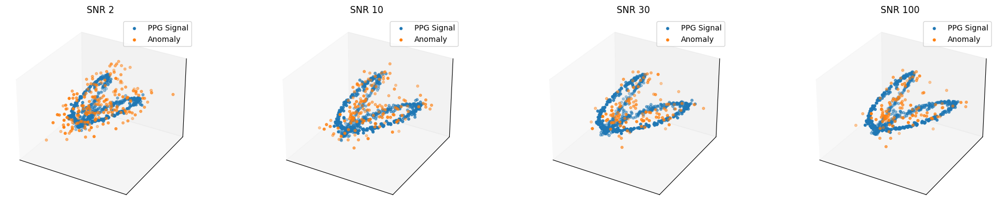

In [30]:
# =============================================================================
# Visualization: HDBSCAN Clustering Results for specific patient Across SNR Levels
# =============================================================================

import pandas as pd
from sklearn.cluster import HDBSCAN
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Prepare to collect statistics (if needed for further analysis)
results_summary = []

# Set up the figure for 3D scatter plots (1 row x 4 columns for each SNR level)
plt.figure(figsize=(20, 4))
n_examples = 4  # Number of SNR levels to plot for patient 50

for idx, (snr, data) in enumerate(results.items()):
    emb_data_ts = data["emb_data_ts"]
    Its = data["Its"]
    Y_anomalies = data["Y_anomalies"]
    Y_signals = datasets[snr]['Y_signals']
    raw_data_ts = data["raw_data_ts"]
    # Select patient 50 (i=50) and find the corresponding example index in Its
    i = 22
    # Find the example index for patient 50 in Its
    try:
        example_idx = list(Its).index(i)
    except ValueError:
        print(f"Patient {i} not found in Its for SNR {snr}.")
        continue
    data = emb_data_ts[example_idx, :, :]
    raw_data = raw_data_ts[example_idx, :, :]
    anomalies = buffer_signal(Y_anomalies[i], w, o)
    max_a = np.max(anomalies, axis=1)

    # Perform HDBSCAN clustering
    hdbscan = HDBSCAN(
            min_cluster_size=15,
            min_samples=1,
            metric='euclidean',
            cluster_selection_epsilon=0.25
        )
    new_labels = hdbscan.fit_predict(data)
    anomalies_dbscan_example = np.hstack(raw_data[longest_negative_sequence(new_labels)])

    # Count cluster labels for summary statistics
    total_points = len(new_labels)
    noise_points = np.sum(new_labels == -1)
    true_noise_points = np.sum(max_a)
    noise_percentage = (noise_points / total_points) * 100

    # 3D scatter plot for each SNR level
    ax = plt.subplot(1, n_examples, idx + 1, projection='3d')
    # Convert labels: -1 for noise, 0 for cluster
    new_labels = [np.int64(0) if l != -1 else np.int64(-1) for l in new_labels]
    unique_labels = set(new_labels)
    for label in unique_labels:
        cluster_data = data[np.array(new_labels) == label]
        ax.scatter(cluster_data[:, 0], cluster_data[:, 1], cluster_data[:, 2], label=f'Cluster {label}', s=10)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.set_title(f'SNR {snr[0]}')
    ax.legend(['PPG Signal', 'Anomaly'])

plt.tight_layout()
plt.savefig("./Figures/BIDMC_ANOMALIES_SUBJECT.png", dpi=800, bbox_inches='tight')
plt.show()
